## Sim Demo

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

  import numpy.matlib as npm

  autumn = cm.get_cmap('autumn', 256)

  winter = cm.get_cmap('winter_r', 256)



In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run)
importlib.reload(models.train_val)
importlib.reload(data.data_utils)
importlib.reload(data.data_load)


<module 'data.data_load' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/data/data_load.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 0.1%
RAM Usage: 2.5%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

## Simulation tests <a id="sims"></a>

In [9]:
torch._dynamo.reset()

In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='spatial',
              random_seed=1,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
Network coverage: 100.0% of regions
Network sizes: [113, 113, 113, 116]
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 977tvhjz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/977tvhjz
Initialized sweep with ID: 977tvhjz
2
3
4
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_constant', 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}


  warnings.warn(



Number of learnable parameters in SMT model: 2162315


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



  from IPython.core.display import display



  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 0.0464
Best val loss so far at epoch 2: 0.0422
Best val loss so far at epoch 4: 0.0383
Best val loss so far at epoch 5: 0.0369
Epoch 5/110, Train Loss: 0.0387, Val Loss: 0.0369, Time: 4.97s
Best val loss so far at epoch 6: 0.0325
Best val loss so far at epoch 8: 0.0289
Best val loss so far at epoch 9: 0.0227
Best val loss so far at epoch 10: 0.0216
Epoch 10/110, Train Loss: 0.0216, Val Loss: 0.0216, Time: 4.73s
Best val loss so far at epoch 12: 0.0211
Best val loss so far at epoch 13: 0.0188
Best val loss so far at epoch 15: 0.0171
Epoch 15/110, Train Loss: 0.0150, Val Loss: 0.0171, Time: 4.68s
Best val loss so far at epoch 16: 0.0165
Best val loss so far at epoch 20: 0.0140
Epoch 20/110, Train Loss: 0.0105, Val Loss: 0.0140, Time: 4.82s
Best val loss so far at epoch 22: 0.0139
Best val loss so far at epoch 23: 0.0131
Best val loss so far at epoch 25: 0.0128
Epoch 25/110, Train 

Full data train

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: ezw4n7yd
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/ezw4n7yd
Initialized sweep with ID: ezw4n7yd


  warnings.warn(



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 10, 'epochs': 125}
Number of learnable parameters in Bilinear low rank model: 73800
  Linear layer 1: 73800 parameters


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB
Best val loss so far at epoch 1: 0.0244
Best val loss so far at epoch 2: 0.0140
Best val loss so far at epoch 3: 0.0110
Epoch 5/125, Train Loss: 0.0197, Val Loss: 0.0330, Time: 3.78s
Best val loss so far at epoch 6: 0.0091
Epoch 10/125, Train Loss: 0.0172, Val Loss: 0.0094, Time: 3.57s
Best val loss so far at epoch 12: 0.0085
Best val loss so far at epoch 15: 0.0085
Epoch 15/125, Train Loss: 0.0160, Val Loss: 0.0085, Time: 3.68s
Best val loss so far at epoch 16: 0.0084
Best val loss so far at epoch 18: 0.0076
Epoch 20/125, Train Loss: 0.3612, Val Loss: 0.0079, Time: 3.53s
Epoch 25/125, Train Loss: 0.0112, Val Loss: 0.0078, Time: 3.73s
Epoch 30/125, Train Loss: 0.0111, Val Loss: 0.0081, Time: 3.75s
Best val loss so far at epoch 33: 0.0075
Epoch 35/125, Train Loss: 0.0099, Val Loss: 0.0075, Time: 3.89s
Epoch 40/125, Train Loss: 0.0099, Val Loss: 0.0090, Time: 4.88s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.

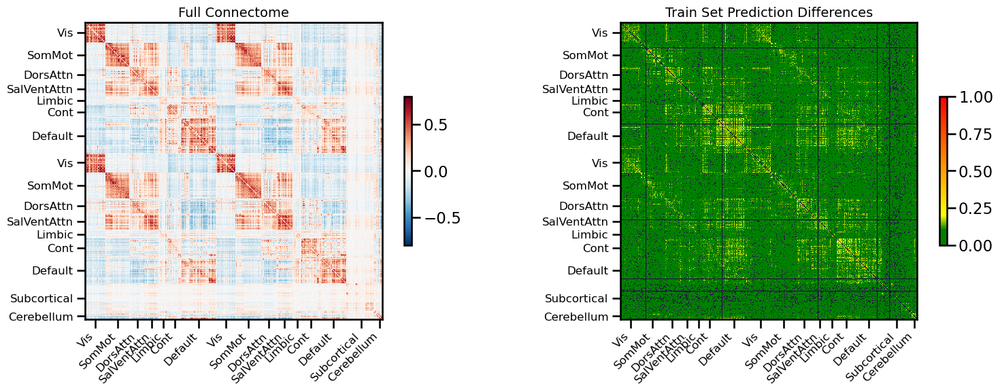

<Figure size 640x480 with 0 Axes>

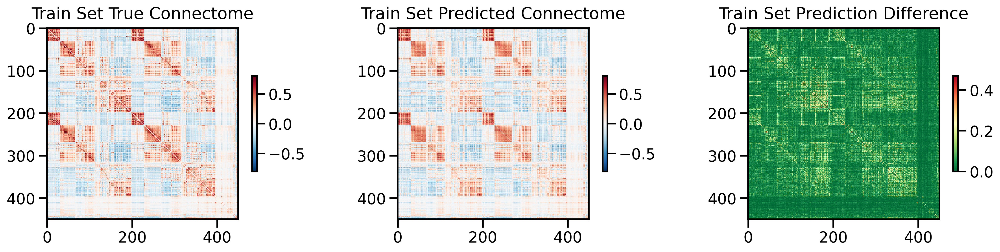

<Figure size 640x480 with 0 Axes>

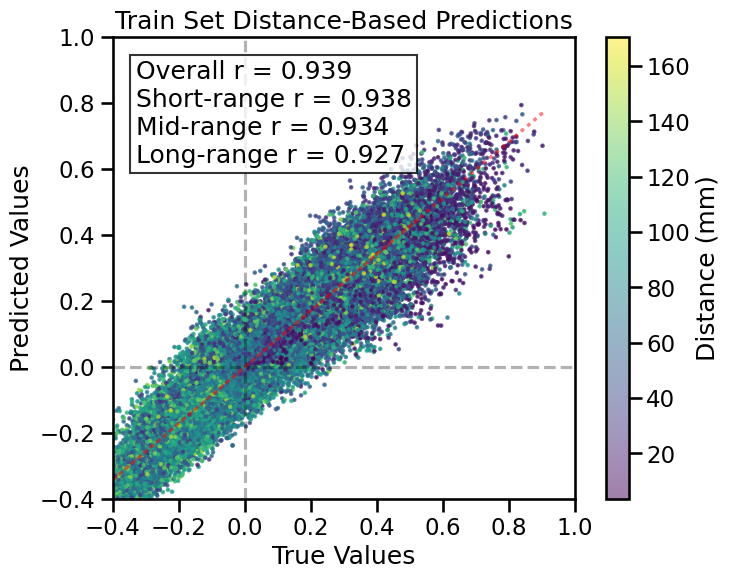

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

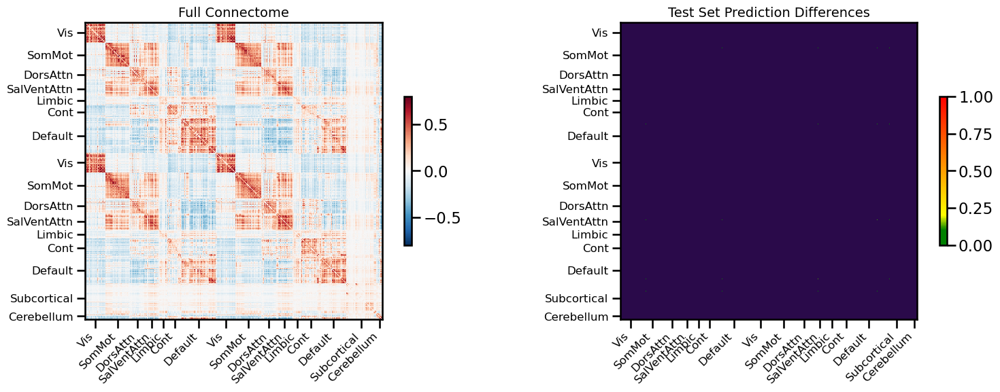

<Figure size 640x480 with 0 Axes>

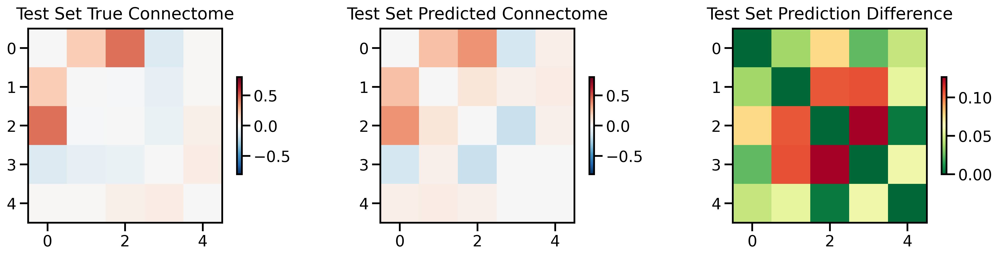

<Figure size 640x480 with 0 Axes>

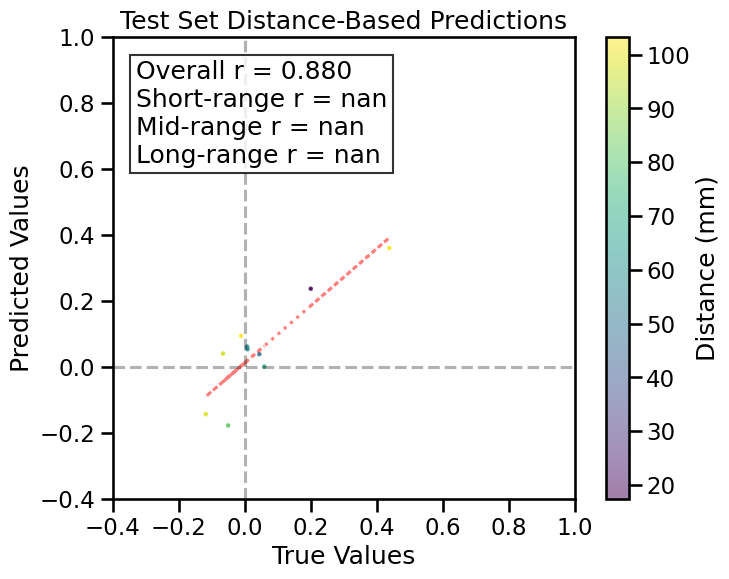

TRAIN METRICS
GLOBAL: mse=0.004031, mae=0.044067, r2=0.8799, pearson_r=0.9386, spearman_r=0.9366, geodesic_distance=18.9962
DISTANCE-BASED: short=0.9380, mid=0.9342, long=0.9273
HEMISPHERIC: left=0.9361, right=0.9432, inter=0.9434
CONNECTION STRENGTH: neg=0.3792, weak=0.9116, pos=0.6087
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9626    0.9534
  Default       0.9029    0.9405
  SalVentAttn    0.9474    0.9440
  Limbic        0.9622    0.9554
  DorsAttn      0.9649    0.9590
  SomMot        0.9538    0.9603
  Vis           0.9600    0.9491
  Subcortical    0.9001    0.9411
  Cerebellum    0.8771    0.9389

TEST METRICS
GLOBAL: mse=0.005510, mae=0.064203, r2=0.7628, pearson_r=0.8803, spearman_r=0.5879, geodesic_distance=2.8916
HEMISPHERIC: left=0.9991, inter=0.9178
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9516
  SalVentAttn       N/A    0.9459
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▃▃▃▂▃▂▂▂▂▃▂▂▂▂▅▂▂▂▂▂▂▁▂▁▂▂▂▂▂▂▃▂▃▃▃▂▂▂▂
train_mse_loss,▂▂▂▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00808
train_mse_loss,0.0066


Final evaluation metrics logged successfully.
CPU Usage: 2.5%
RAM Usage: 5.7%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 533.74 seconds (8.90 minutes)


0

<Figure size 640x480 with 0 Axes>

In [16]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='bilinear_lowrank',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_blr_full'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: fdpk2zbv
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/fdpk2zbv
Initialized sweep with ID: fdpk2zbv


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 7723777


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0140
Best val loss so far at epoch 2: 0.0103
Best val loss so far at epoch 3: 0.0103
Best val loss so far at epoch 4: 0.0086
Epoch 5/125, Train Loss: 0.0174, Val Loss: 0.0117, Time: 3.53s
Best val loss so far at epoch 8: 0.0063
Epoch 10/125, Train Loss: 0.0069, Val Loss: 0.0114, Time: 3.85s
Epoch 15/125, Train Loss: 0.0049, Val Loss: 0.0099, Time: 3.49s
Epoch 20/125, Train Loss: 0.0039, Val Loss: 0.0069, Time: 3.86s
Epoch 25/125, Train Loss: 0.0034, Val Loss: 0.0159, Time: 4.04s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.008057
Epoch 30/125, Train Loss: 0.0025, Val Loss: 0.0074, Time: 4.65s
Epoch 35/125, Train Loss: 0.0023, Val Loss: 0.0094, Time: 3.62s
Epoch 40/125, Train Loss: 0.0022, Val Loss: 0.0117, Time: 3.75s
Epoch 45/125, Train Loss: 0.0021, Val Loss: 0.0123, Time: 3.88s
Epoch 50/125, Train Loss: 0.0020, Val Loss: 0.0088, Time: 4.15s

LR REDUCED: 0.000027 → 0.0000

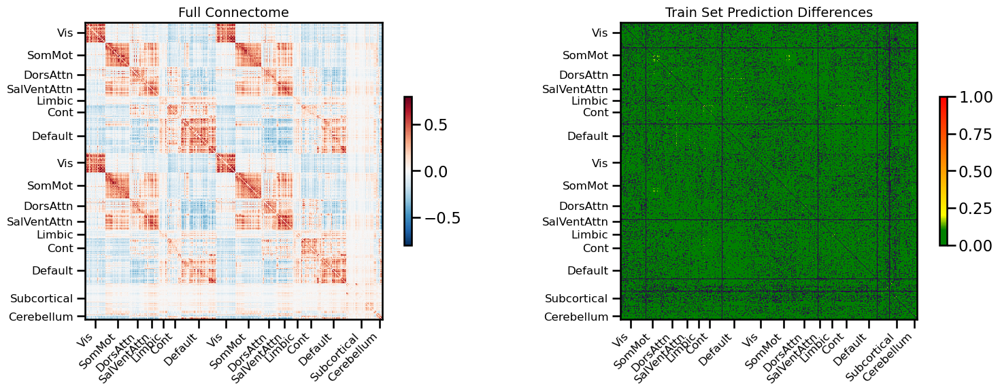

<Figure size 640x480 with 0 Axes>

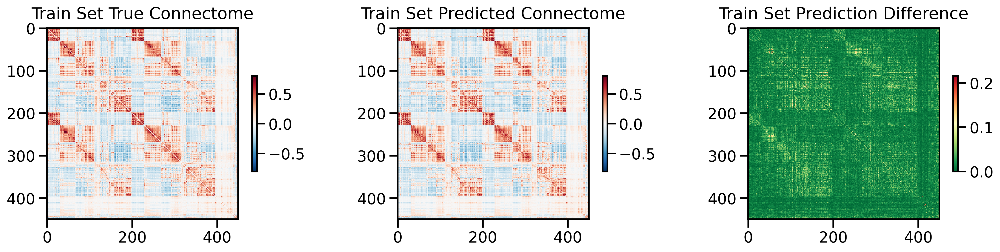

<Figure size 640x480 with 0 Axes>

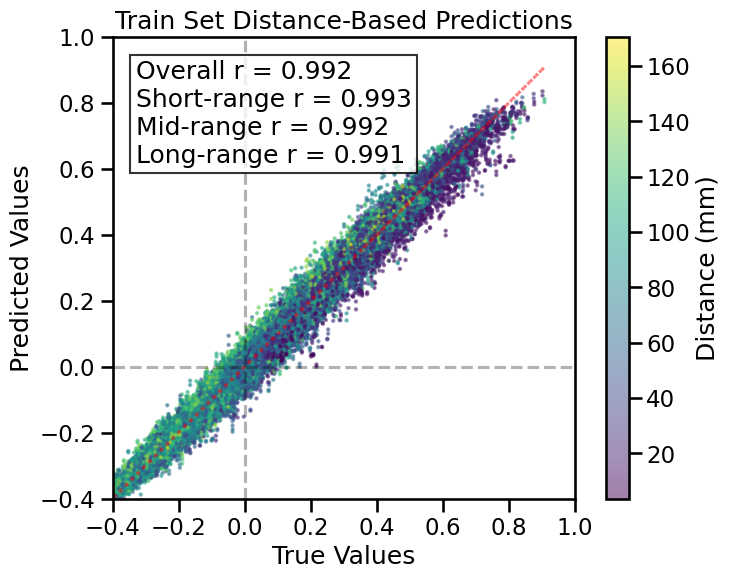

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

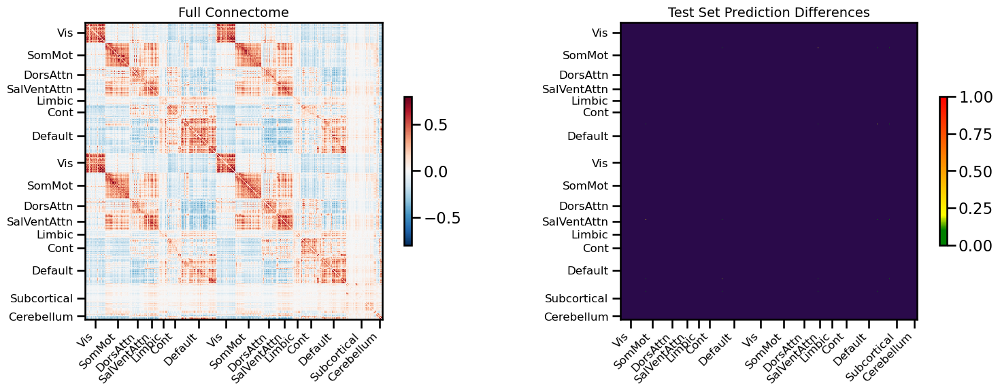

<Figure size 640x480 with 0 Axes>

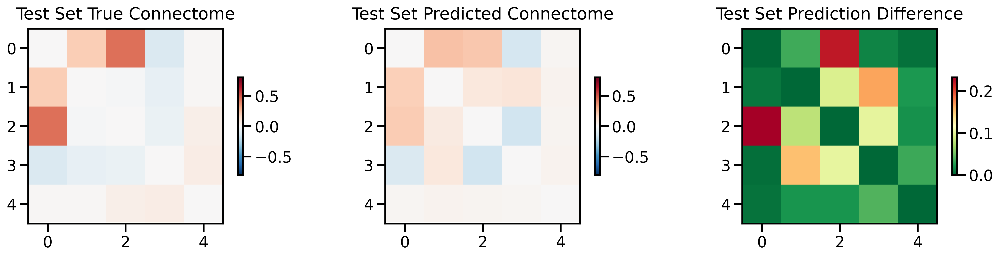

<Figure size 640x480 with 0 Axes>

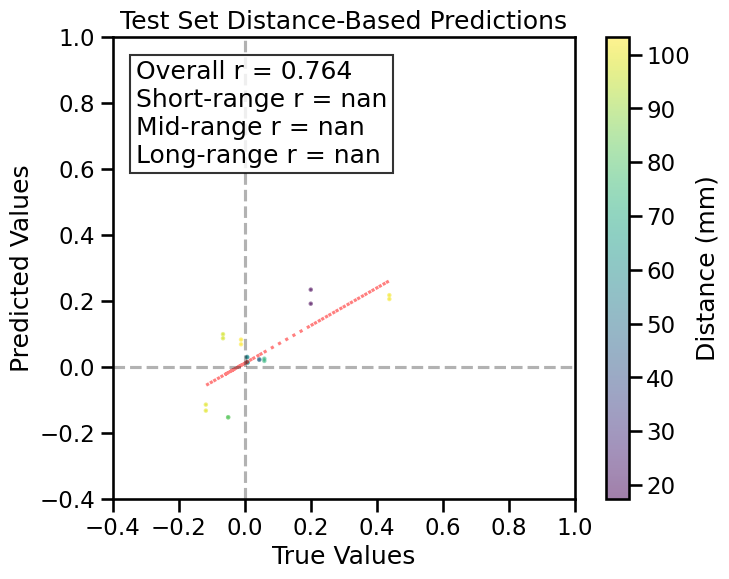

TRAIN METRICS
GLOBAL: mse=0.000518, mae=0.016546, r2=0.9846, pearson_r=0.9924, spearman_r=0.9902, geodesic_distance=15.6082
DISTANCE-BASED: short=0.9930, mid=0.9916, long=0.9910
HEMISPHERIC: left=0.9926, right=0.9943, inter=0.9933
CONNECTION STRENGTH: neg=0.8618, weak=0.9865, pos=0.9469
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9928    0.9935
  Default       0.9864    0.9907
  SalVentAttn    0.9896    0.9917
  Limbic        0.9927    0.9928
  DorsAttn      0.9951    0.9940
  SomMot        0.9950    0.9943
  Vis           0.9954    0.9934
  Subcortical    0.9904    0.9909
  Cerebellum    0.9777    0.9920

TEST METRICS
GLOBAL: mse=0.009782, mae=0.069222, r2=0.5789, pearson_r=0.7640, spearman_r=0.5132, geodesic_distance=3.7690
HEMISPHERIC: left=0.9970, inter=0.7709
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.8716
  SalVentAttn       N/A    0.9290
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▁▅▄▆▃▆▃▃█▄▁▃▃▃▂▂▄▄▃▃▂▂▂▃▂▃▃▂▃▂▂▂▃▃▂▃▃▃▃▃
train_mse_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00978
train_mse_loss,0.00144


Final evaluation metrics logged successfully.
CPU Usage: 2.9%
RAM Usage: 6.8%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 513.01 seconds (8.55 minutes)


0

<Figure size 640x480 with 0 Axes>

In [19]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_mlp_full'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
feature_name: euclidean, processing_type: None
features ['transcriptome', 'euclidean']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: zfxdtttm
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/zfxdtttm
Initialized sweep with ID: zfxdtttm


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 7726849


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0147
Best val loss so far at epoch 2: 0.0115
Best val loss so far at epoch 4: 0.0097
Epoch 5/125, Train Loss: 0.0146, Val Loss: 0.0146, Time: 4.13s
Best val loss so far at epoch 6: 0.0093
Best val loss so far at epoch 8: 0.0056
Epoch 10/125, Train Loss: 0.0055, Val Loss: 0.0130, Time: 4.63s
Best val loss so far at epoch 12: 0.0045
Epoch 15/125, Train Loss: 0.0037, Val Loss: 0.0073, Time: 4.07s
Epoch 20/125, Train Loss: 0.0029, Val Loss: 0.0125, Time: 4.83s
Epoch 25/125, Train Loss: 0.0025, Val Loss: 0.0051, Time: 3.60s
Best val loss so far at epoch 30: 0.0032
Epoch 30/125, Train Loss: 0.0022, Val Loss: 0.0032, Time: 4.26s
Epoch 35/125, Train Loss: 0.0020, Val Loss: 0.0032, Time: 4.51s
Epoch 40/125, Train Loss: 0.0018, Val Loss: 0.0075, Time: 3.63s
Best val loss so far at epoch 42: 0.0031
Best val loss so far at epoch 45: 0.0028
Epoch 45/125, Train Loss: 0.0016, Val Loss: 0.002

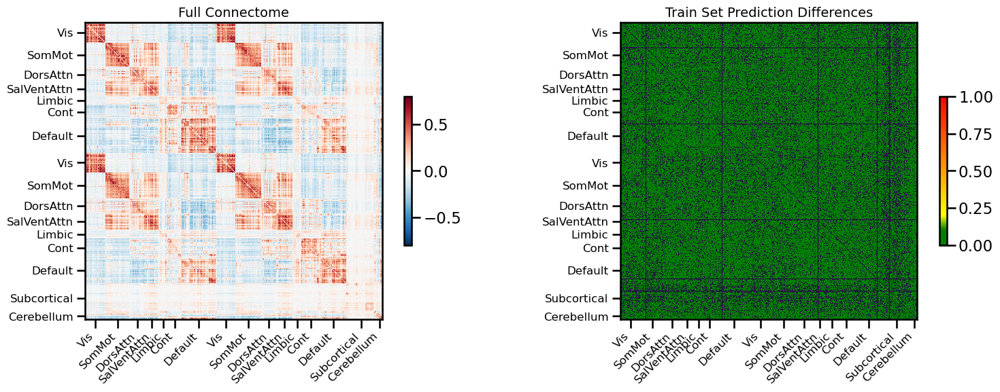

<Figure size 640x480 with 0 Axes>

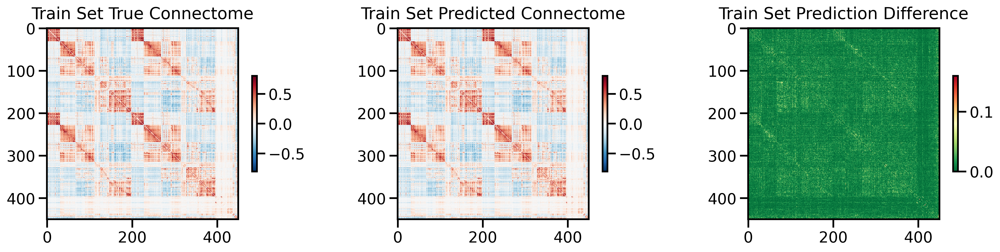

<Figure size 640x480 with 0 Axes>

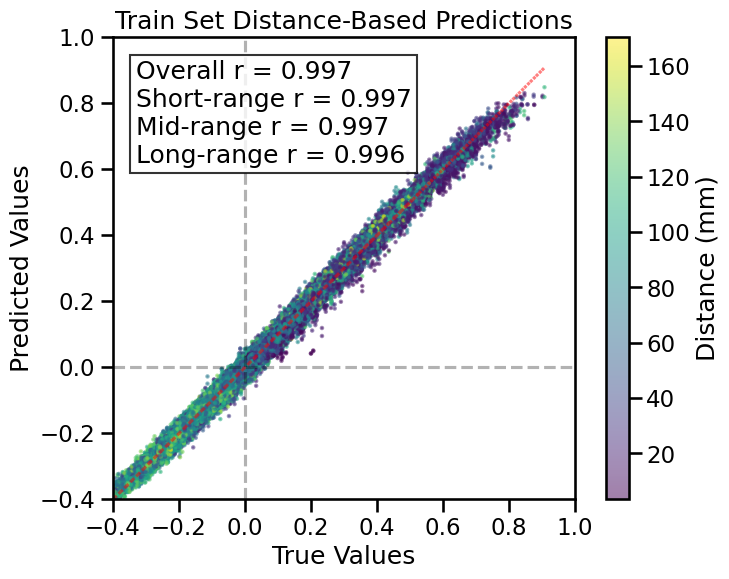

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

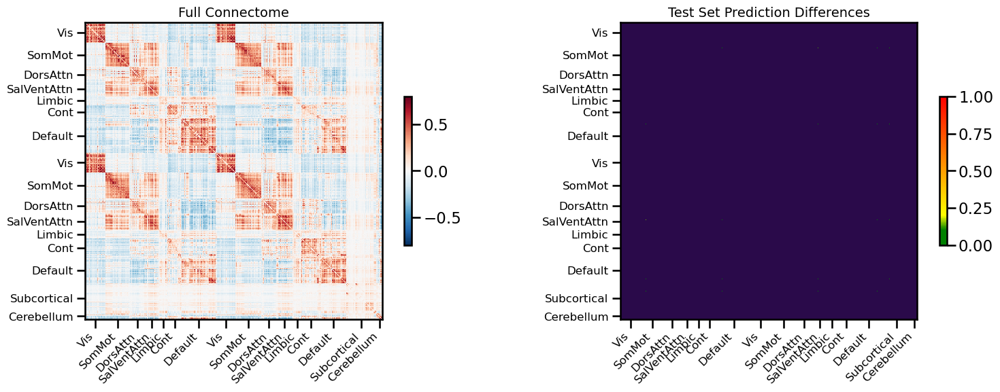

<Figure size 640x480 with 0 Axes>

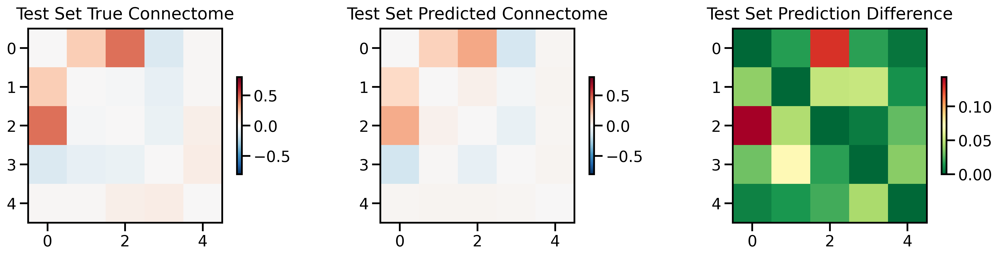

<Figure size 640x480 with 0 Axes>

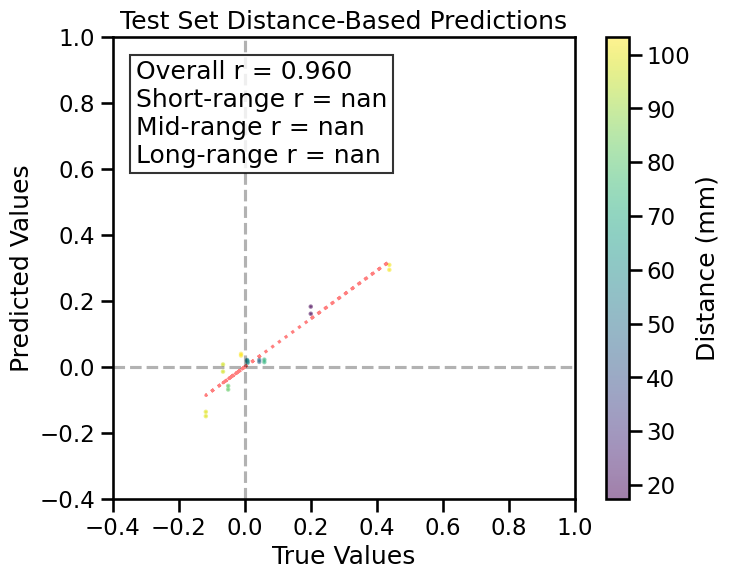

TRAIN METRICS
GLOBAL: mse=0.000208, mae=0.010931, r2=0.9938, pearson_r=0.9969, spearman_r=0.9957, geodesic_distance=14.2710
DISTANCE-BASED: short=0.9972, mid=0.9965, long=0.9962
HEMISPHERIC: left=0.9971, right=0.9972, inter=0.9969
CONNECTION STRENGTH: neg=0.9178, weak=0.9943, pos=0.9833
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9968    0.9972
  Default       0.9957    0.9967
  SalVentAttn    0.9968    0.9967
  Limbic        0.9971    0.9972
  DorsAttn      0.9975    0.9972
  SomMot        0.9971    0.9974
  Vis           0.9978    0.9971
  Subcortical    0.9965    0.9969
  Cerebellum    0.9951    0.9970

TEST METRICS
GLOBAL: mse=0.002920, mae=0.039688, r2=0.8743, pearson_r=0.9603, spearman_r=0.8060, geodesic_distance=1.8019
HEMISPHERIC: left=0.9990, inter=0.9683
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9764
  SalVentAttn       N/A    0.9570
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▅▇▄▇▄▂█▃▃▂▃▂▅▂▄▂▁▂▃▃▁▂▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00292
train_mse_loss,0.0009


Final evaluation metrics logged successfully.
CPU Usage: 2.6%
RAM Usage: 6.5%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 617.08 seconds (10.28 minutes)


0

<Figure size 640x480 with 0 Axes>

In [20]:
single_sim_run(
              feature_type=[{'transcriptome': None}, 
                            {'euclidean': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_mlpcoords_full'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Calling wandb.login() after wandb.init() has no effect.
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 5ctu6sxe
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/5ctu6sxe
Initialized sweep with ID: 5ctu6sxe


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'aug_style': 'linear_decay', 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 2162315


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0162
Best val loss so far at epoch 2: 0.0091
Epoch 5/110, Train Loss: 0.0331, Val Loss: 0.0126, Time: 7.12s
Best val loss so far at epoch 7: 0.0084
Best val loss so far at epoch 8: 0.0075
Best val loss so far at epoch 9: 0.0056
Epoch 10/110, Train Loss: 0.0154, Val Loss: 0.0063, Time: 7.23s
Best val loss so far at epoch 11: 0.0053
Best val loss so far at epoch 13: 0.0048
Best val loss so far at epoch 15: 0.0040
Epoch 15/110, Train Loss: 0.0095, Val Loss: 0.0040, Time: 7.69s
Best val loss so far at epoch 17: 0.0038
Best val loss so far at epoch 18: 0.0035
Best val loss so far at epoch 19: 0.0032
Best val loss so far at epoch 20: 0.0027
Epoch 20/110, Train Loss: 0.0063, Val Loss: 0.0027, Time: 7.29s
Epoch 25/110, Train Loss: 0.0047, Val Loss: 0.0032, Time: 7.25s
Best val loss so far at epoch 29: 0.0024
Best val loss so far at epoch 30: 0.0018
Epoch 30/110, Train Loss: 0.0037, Va

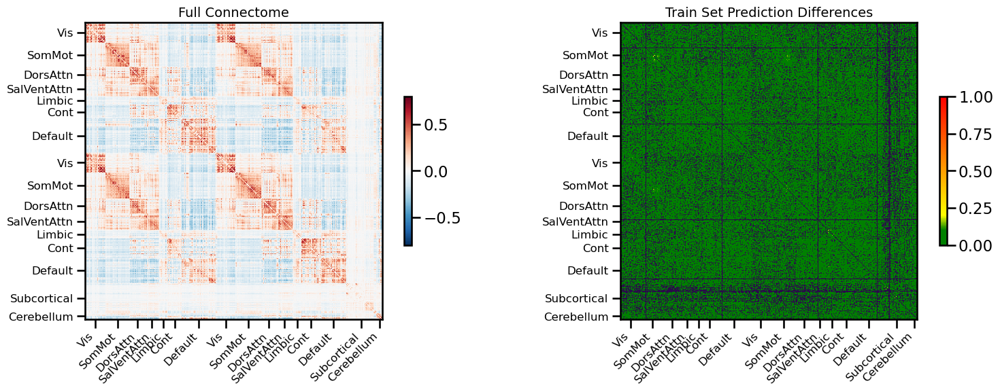

<Figure size 640x480 with 0 Axes>

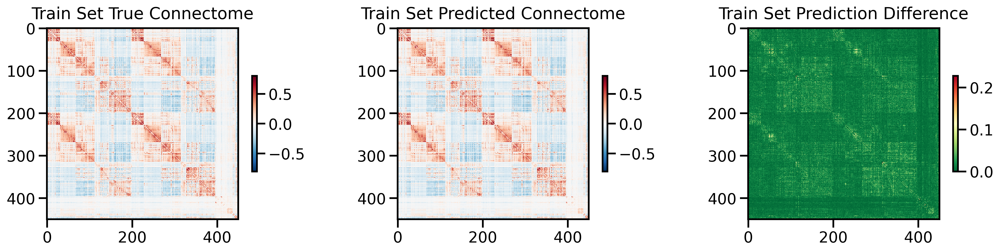

<Figure size 640x480 with 0 Axes>

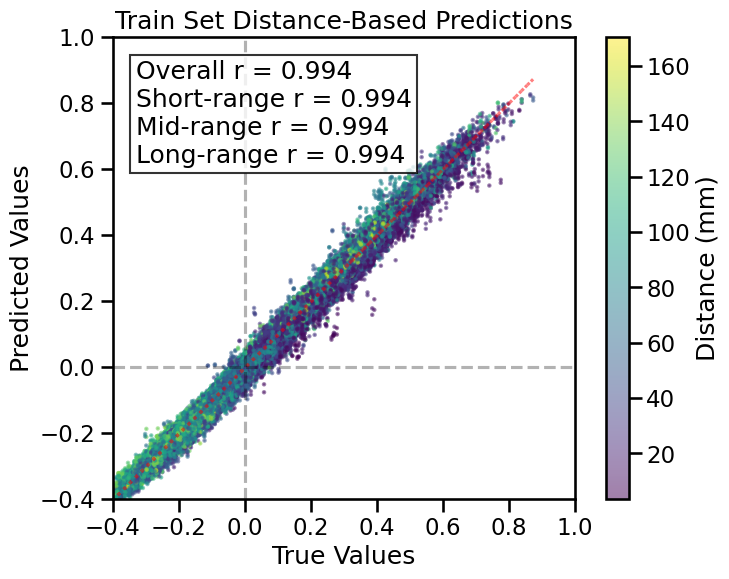

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

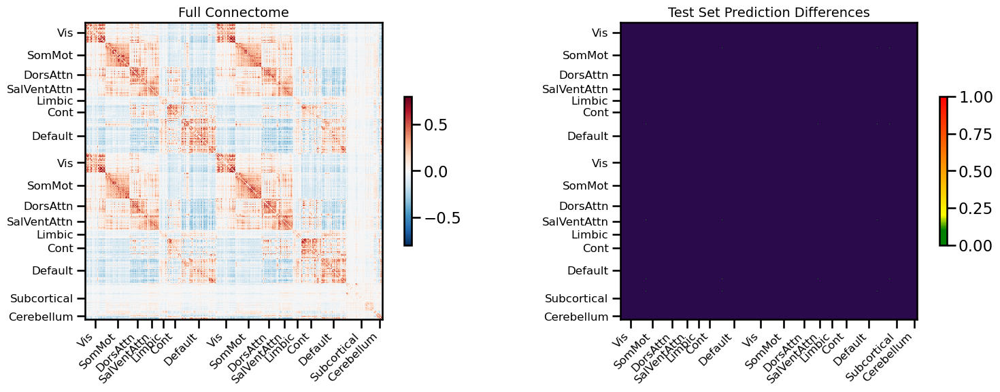

<Figure size 640x480 with 0 Axes>

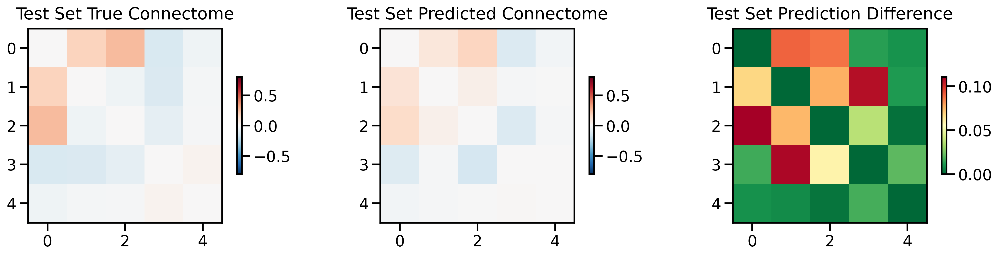

<Figure size 640x480 with 0 Axes>

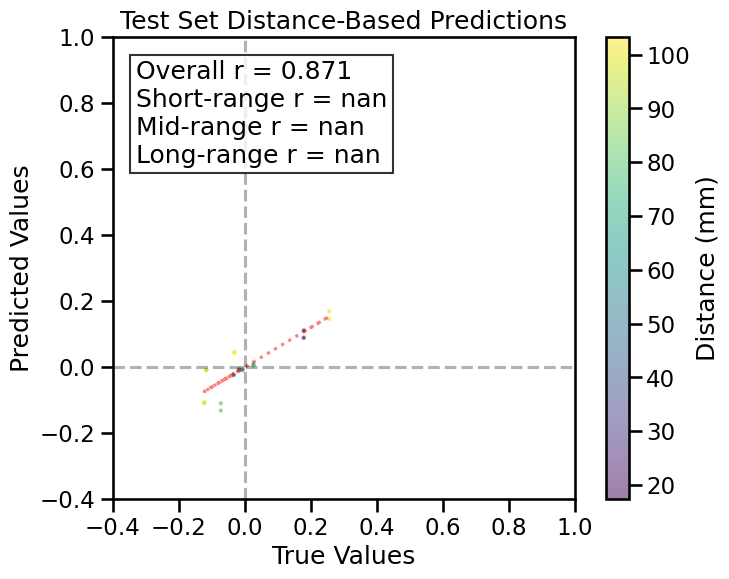

TRAIN METRICS
GLOBAL: mse=0.000304, mae=0.012549, r2=0.9877, pearson_r=0.9940, spearman_r=0.9917, geodesic_distance=13.6915
DISTANCE-BASED: short=0.9939, mid=0.9941, long=0.9940
HEMISPHERIC: left=0.9938, right=0.9946, inter=0.9949
CONNECTION STRENGTH: neg=0.8622, weak=0.9907, pos=0.9494
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9938    0.9945
  Default       0.9946    0.9943
  SalVentAttn    0.9912    0.9932
  Limbic        0.9937    0.9935
  DorsAttn      0.9925    0.9945
  SomMot        0.9954    0.9950
  Vis           0.9944    0.9944
  Subcortical    0.9949    0.9940
  Cerebellum    0.9957    0.9943

TEST METRICS
GLOBAL: mse=0.003685, mae=0.046623, r2=0.7259, pearson_r=0.8715, spearman_r=0.8332, geodesic_distance=2.8042
HEMISPHERIC: left=0.9969, inter=0.8980
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9392
  SalVentAttn       N/A    0.9020
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▆▆▅▄▃▂▃▂▂▂▂▂▁▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
train_mse_loss,█▄▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00368
train_mse_loss,0.00099


Final evaluation metrics logged successfully.
CPU Usage: 3.2%
RAM Usage: 4.6%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 924.99 seconds (15.42 minutes)


12416

<Figure size 640x480 with 0 Axes>

In [10]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_smt_full1'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: ryc1gzzz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/ryc1gzzz
Initialized sweep with ID: ryc1gzzz


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'aug_style': 'linear_decay', 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 2162315


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0162
Best val loss so far at epoch 2: 0.0091
Epoch 5/110, Train Loss: 0.0331, Val Loss: 0.0126, Time: 7.09s
Best val loss so far at epoch 7: 0.0084
Best val loss so far at epoch 8: 0.0075
Best val loss so far at epoch 9: 0.0056
Epoch 10/110, Train Loss: 0.0154, Val Loss: 0.0063, Time: 7.30s
Best val loss so far at epoch 11: 0.0053
Best val loss so far at epoch 13: 0.0048
Best val loss so far at epoch 15: 0.0040
Epoch 15/110, Train Loss: 0.0095, Val Loss: 0.0040, Time: 7.12s
Best val loss so far at epoch 17: 0.0038
Best val loss so far at epoch 18: 0.0035
Best val loss so far at epoch 19: 0.0032
Best val loss so far at epoch 20: 0.0027
Epoch 20/110, Train Loss: 0.0063, Val Loss: 0.0027, Time: 7.09s
Epoch 25/110, Train Loss: 0.0047, Val Loss: 0.0032, Time: 7.08s
Best val loss so far at epoch 29: 0.0024
Best val loss so far at epoch 30: 0.0018
Epoch 30/110, Train Loss: 0.0037, Va

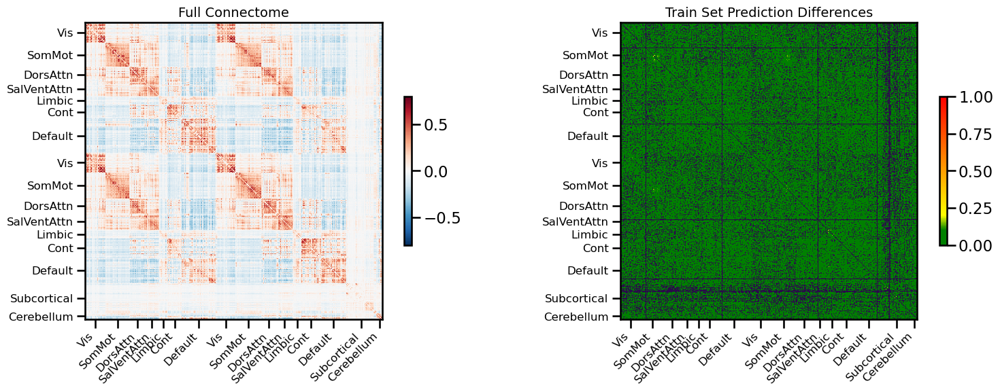

<Figure size 640x480 with 0 Axes>

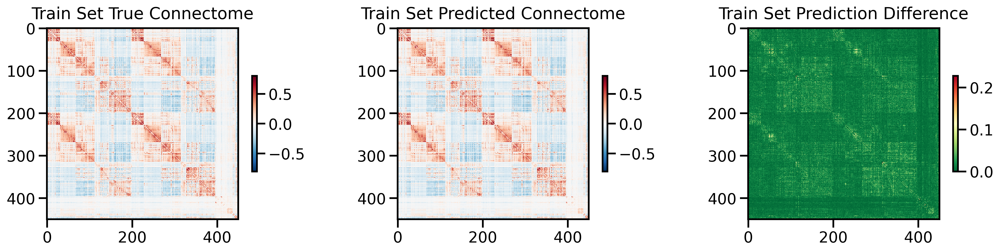

<Figure size 640x480 with 0 Axes>

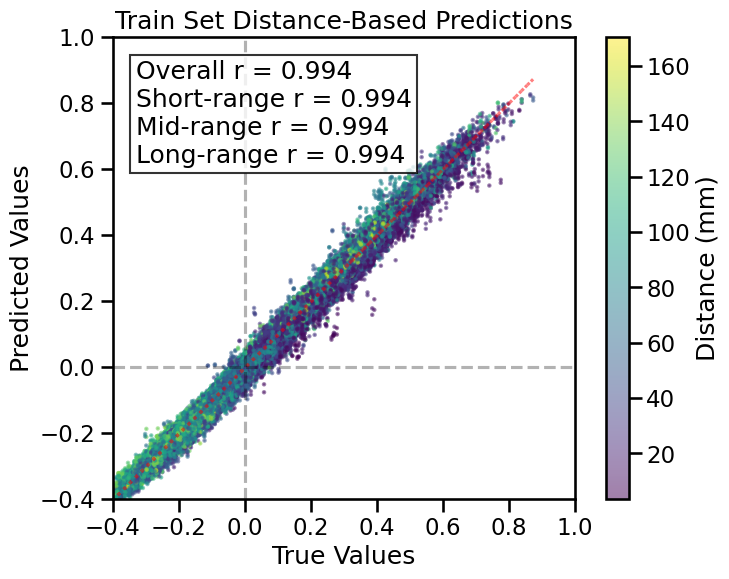

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

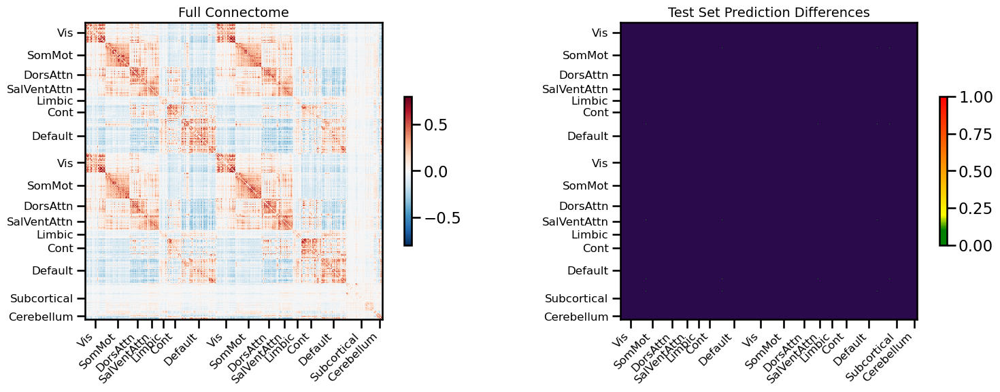

<Figure size 640x480 with 0 Axes>

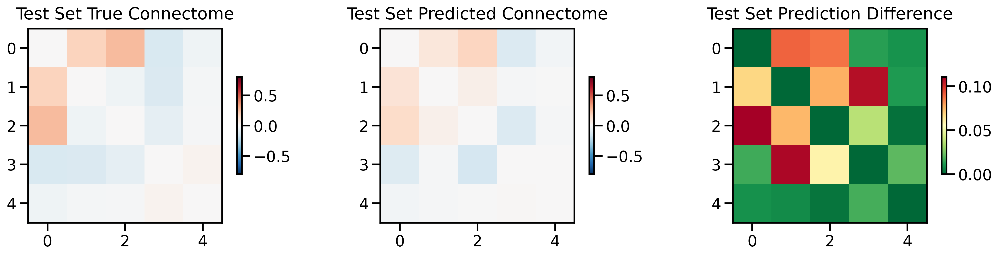

<Figure size 640x480 with 0 Axes>

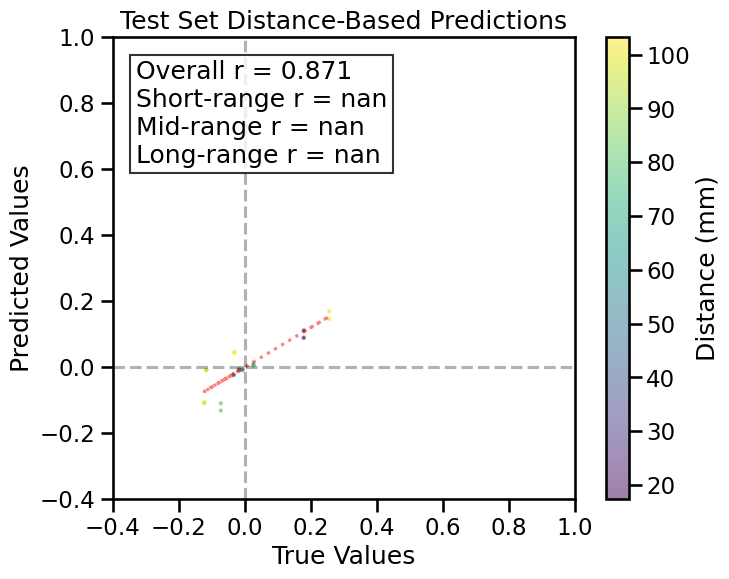

TRAIN METRICS
GLOBAL: mse=0.000304, mae=0.012549, r2=0.9877, pearson_r=0.9940, spearman_r=0.9917, geodesic_distance=13.6915
DISTANCE-BASED: short=0.9939, mid=0.9941, long=0.9940
HEMISPHERIC: left=0.9938, right=0.9946, inter=0.9949
CONNECTION STRENGTH: neg=0.8622, weak=0.9907, pos=0.9494
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9938    0.9945
  Default       0.9946    0.9943
  SalVentAttn    0.9912    0.9932
  Limbic        0.9937    0.9935
  DorsAttn      0.9925    0.9945
  SomMot        0.9954    0.9950
  Vis           0.9944    0.9944
  Subcortical    0.9949    0.9940
  Cerebellum    0.9957    0.9943

TEST METRICS
GLOBAL: mse=0.003685, mae=0.046623, r2=0.7259, pearson_r=0.8715, spearman_r=0.8332, geodesic_distance=2.8042
HEMISPHERIC: left=0.9969, inter=0.8980
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9392
  SalVentAttn       N/A    0.9020
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▆█▇▅▄▃▂▂▁▂▂▂▁▂▂▁▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
train_mse_loss,█▆▅▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00368
train_mse_loss,0.00099


Final evaluation metrics logged successfully.
CPU Usage: 3.2%
RAM Usage: 4.6%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 939.75 seconds (15.66 minutes)


12416

<Figure size 640x480 with 0 Axes>

In [11]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_smt_full2'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: jtcnpyx7
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/jtcnpyx7
Initialized sweep with ID: jtcnpyx7


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'aug_style': 'linear_decay', 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 2162315


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0171
Best val loss so far at epoch 2: 0.0103
Best val loss so far at epoch 3: 0.0099
Epoch 5/110, Train Loss: 0.0311, Val Loss: 0.0129, Time: 7.29s
Best val loss so far at epoch 7: 0.0094
Best val loss so far at epoch 8: 0.0090
Best val loss so far at epoch 9: 0.0065
Epoch 10/110, Train Loss: 0.0187, Val Loss: 0.0067, Time: 7.24s
Best val loss so far at epoch 11: 0.0053
Epoch 15/110, Train Loss: 0.0133, Val Loss: 0.0078, Time: 7.11s
Best val loss so far at epoch 18: 0.0050
Best val loss so far at epoch 19: 0.0041
Epoch 20/110, Train Loss: 0.0094, Val Loss: 0.0055, Time: 7.02s
Best val loss so far at epoch 22: 0.0036
Epoch 25/110, Train Loss: 0.0066, Val Loss: 0.0056, Time: 7.39s
Epoch 30/110, Train Loss: 0.0045, Val Loss: 0.0054, Time: 7.09s
Epoch 35/110, Train Loss: 0.0036, Val Loss: 0.0054, Time: 7.11s
Epoch 40/110, Train Loss: 0.0030, Val Loss: 0.0046, Time: 7.05s
Best val 

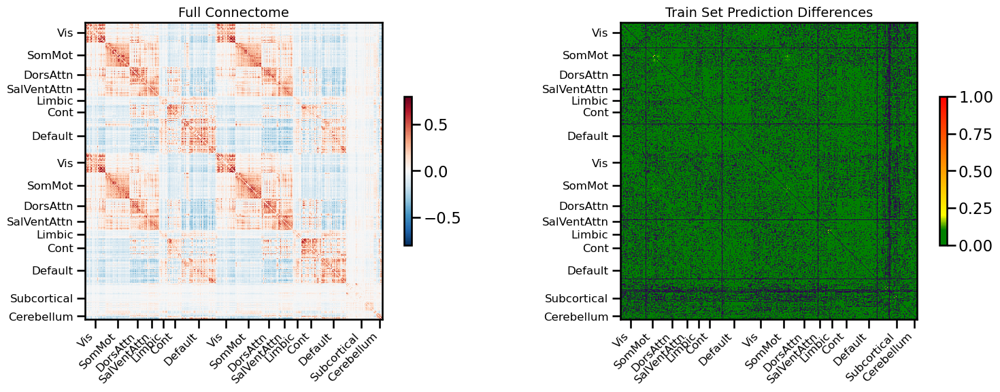

<Figure size 640x480 with 0 Axes>

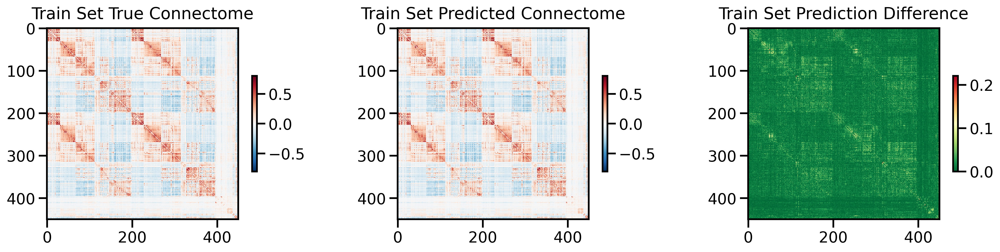

<Figure size 640x480 with 0 Axes>

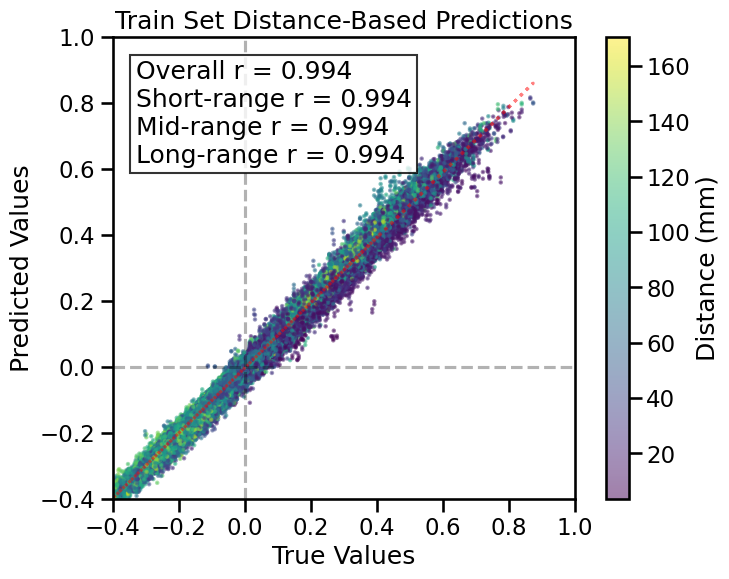

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

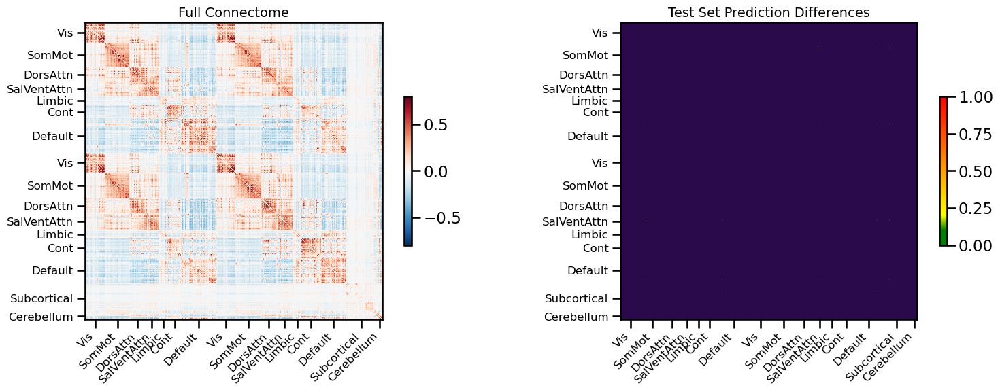

<Figure size 640x480 with 0 Axes>

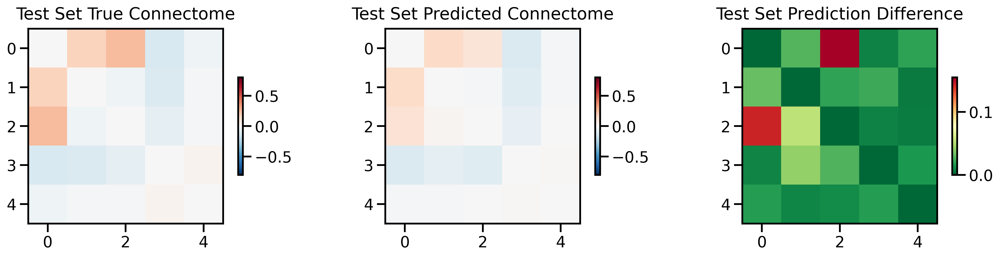

<Figure size 640x480 with 0 Axes>

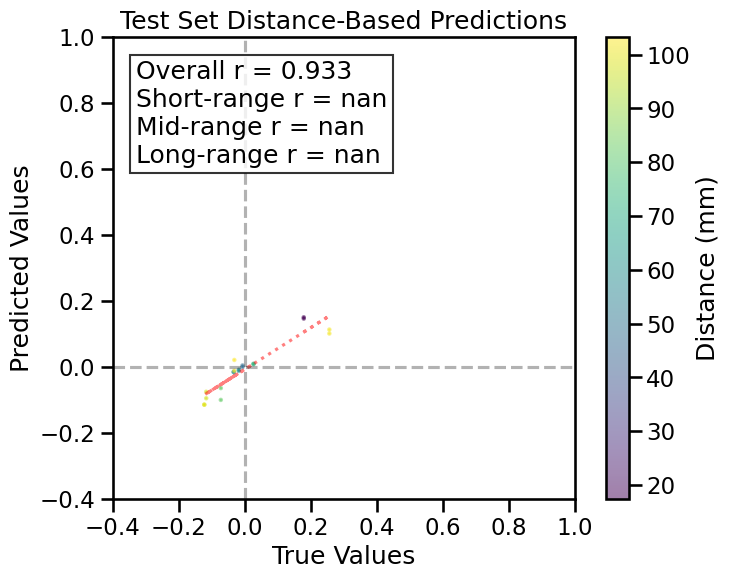

TRAIN METRICS
GLOBAL: mse=0.000302, mae=0.012464, r2=0.9878, pearson_r=0.9940, spearman_r=0.9918, geodesic_distance=12.9276
DISTANCE-BASED: short=0.9938, mid=0.9941, long=0.9938
HEMISPHERIC: left=0.9933, right=0.9941, inter=0.9944
CONNECTION STRENGTH: neg=0.8600, weak=0.9907, pos=0.9497
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9926    0.9943
  Default       0.9945    0.9941
  SalVentAttn    0.9915    0.9930
  Limbic        0.9915    0.9937
  DorsAttn      0.9921    0.9943
  SomMot        0.9951    0.9948
  Vis           0.9944    0.9943
  Subcortical    0.9947    0.9940
  Cerebellum    0.9940    0.9940

TEST METRICS
GLOBAL: mse=0.002704, mae=0.032743, r2=0.7989, pearson_r=0.9329, spearman_r=0.9389, geodesic_distance=1.8852
HEMISPHERIC: left=0.9985, inter=0.9557
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9060
  SalVentAttn       N/A    0.9931
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▆██▆▅▃▃▃▃▃▂▃▃▃▄▄▂▂▁▁▂▂▁▃▂▂▁▁▂▂▁▁▁▁▁▂▂▁▂▁
train_mse_loss,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.0027
train_mse_loss,0.00095


Final evaluation metrics logged successfully.
CPU Usage: 3.2%
RAM Usage: 4.6%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 938.93 seconds (15.65 minutes)


8346

<Figure size 640x480 with 0 Axes>

In [12]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_smt_full3'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Calling wandb.login() after wandb.init() has no effect.
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: m35jfvul
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/m35jfvul
Initialized sweep with ID: m35jfvul


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'aug_style': 'linear_decay', 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 2173067


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.11 GB


Exception ignored in: <function ExactWeakKeyDictionary.__setitem__.<locals>.<lambda> at 0x15473a3a2160>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/torch/_dynamo/utils.py", line 478, in <lambda>
    self.refs[idx] = weakref.ref(key, lambda ref: self._remove_id(idx))
                                                  ^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/torch/_dynamo/utils.py", line 775, in _remove_id
    hook()
  File "/ext3/miniconda3/lib/python3.11/site-packages/torch/_dynamo/utils.py", line 759, in __call__
    del self.scope[self.name]
        ~~~~~~~~~~^^^^^^^^^^^
KeyError: '__builtins_dict___8'
Exception ignored in: <function ExactWeakKeyDictionary.__setitem__.<locals>.<lambda> at 0x1545065d34c0>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/torch/_dynamo/utils.py", line 478, in <lambda>
    self.refs[idx] = weakref.ref(key, lambda ref: self._remove_id(idx)

Best val loss so far at epoch 1: 0.0093
Best val loss so far at epoch 2: 0.0090
Best val loss so far at epoch 3: 0.0088
Best val loss so far at epoch 4: 0.0078
Epoch 5/110, Train Loss: 0.0385, Val Loss: 0.0078, Time: 7.28s
Best val loss so far at epoch 6: 0.0071
Best val loss so far at epoch 7: 0.0063
Best val loss so far at epoch 8: 0.0047
Best val loss so far at epoch 9: 0.0047
Epoch 10/110, Train Loss: 0.0201, Val Loss: 0.0047, Time: 7.31s
Epoch 15/110, Train Loss: 0.0149, Val Loss: 0.0105, Time: 7.18s
Epoch 20/110, Train Loss: 0.0101, Val Loss: 0.0173, Time: 7.16s
Epoch 25/110, Train Loss: 0.0067, Val Loss: 0.0107, Time: 7.28s
Epoch 30/110, Train Loss: 0.0049, Val Loss: 0.0152, Time: 7.29s
Epoch 35/110, Train Loss: 0.0037, Val Loss: 0.0146, Time: 7.24s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.006378
Best val loss so far at epoch 40: 0.0042
Epoch 40/110, Train Loss: 0.0028, Val Loss: 0.0042, Time: 7.13s
Epoch 45/110, Train Loss: 0.0025, Val Loss: 0.0054, Time: 7.17s
Epoch 50/

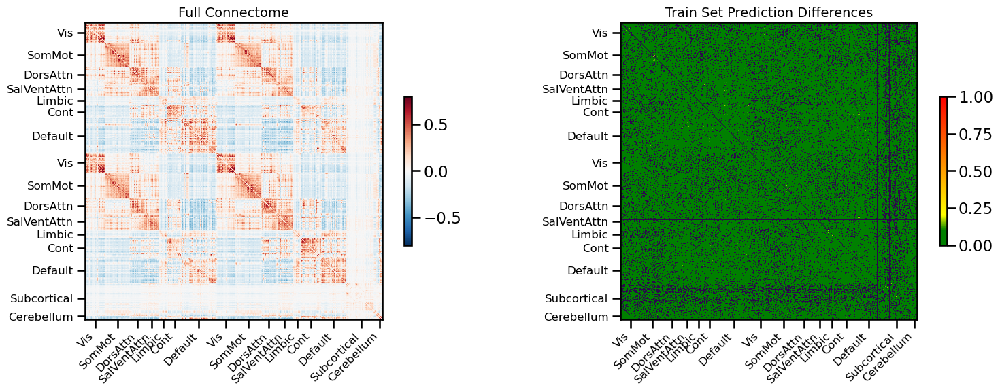

<Figure size 640x480 with 0 Axes>

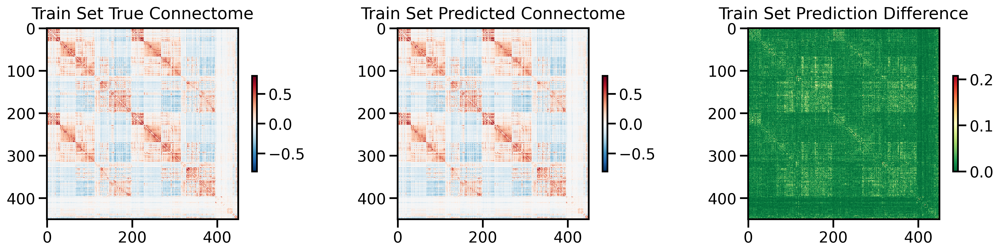

<Figure size 640x480 with 0 Axes>

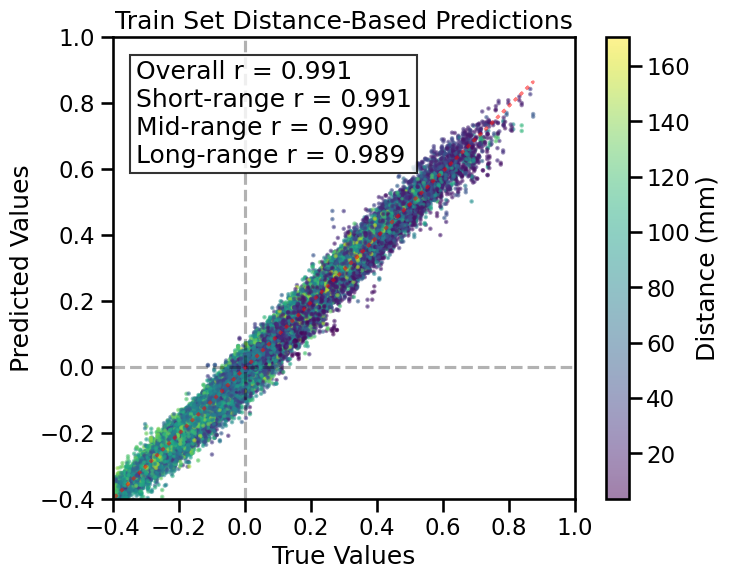

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

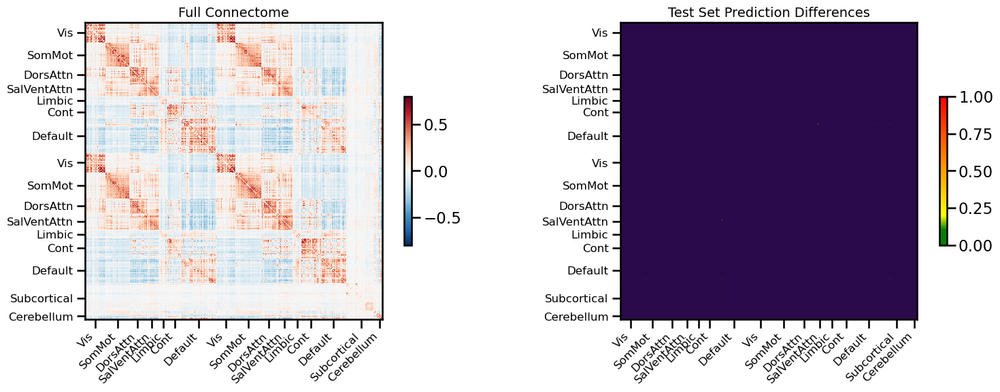

<Figure size 640x480 with 0 Axes>

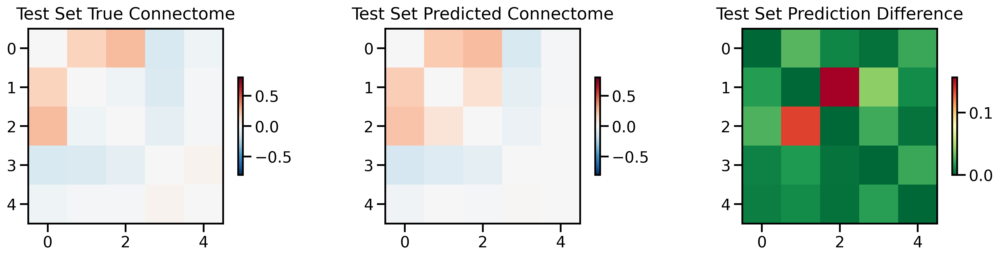

<Figure size 640x480 with 0 Axes>

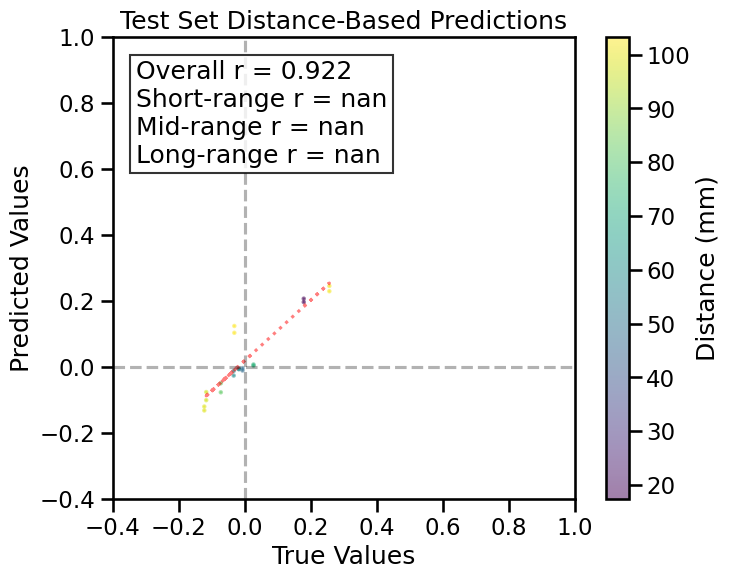

TRAIN METRICS
GLOBAL: mse=0.000477, mae=0.015769, r2=0.9806, pearson_r=0.9906, spearman_r=0.9857, geodesic_distance=14.6169
DISTANCE-BASED: short=0.9912, mid=0.9896, long=0.9888
HEMISPHERIC: left=0.9893, right=0.9918, inter=0.9903
CONNECTION STRENGTH: neg=0.7889, weak=0.9845, pos=0.9423
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9909    0.9913
  Default       0.9905    0.9909
  SalVentAttn    0.9917    0.9911
  Limbic        0.9910    0.9916
  DorsAttn      0.9907    0.9921
  SomMot        0.9919    0.9914
  Vis           0.9915    0.9907
  Subcortical    0.9901    0.9902
  Cerebellum    0.9849    0.9905

TEST METRICS
GLOBAL: mse=0.002455, mae=0.028710, r2=0.8174, pearson_r=0.9222, spearman_r=0.9147, geodesic_distance=3.0187
HEMISPHERIC: left=0.9990, inter=0.8837
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9337
  SalVentAttn       N/A    0.8588
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▂▃▄▄▅█▅▅▄█▃▃▃▃▃▃▂▂▂▂▂▂▂▁▂▂▁▂▂▁▂▁▁▁▂▁▁▁▁▁
train_mse_loss,█▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00245
train_mse_loss,0.00126


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 4.8%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  2% |
Sim complete
Simulation completed in 971.07 seconds (16.18 minutes)


12720

<Figure size 640x480 with 0 Axes>

In [14]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_smtcls_full1'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 8u2nfxar
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/8u2nfxar
Initialized sweep with ID: 8u2nfxar


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'aug_style': 'linear_decay', 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 2173067


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0112
Best val loss so far at epoch 2: 0.0095
Best val loss so far at epoch 3: 0.0095
Best val loss so far at epoch 4: 0.0080
Best val loss so far at epoch 5: 0.0076
Epoch 5/110, Train Loss: 0.0386, Val Loss: 0.0076, Time: 7.41s
Best val loss so far at epoch 6: 0.0073
Best val loss so far at epoch 7: 0.0073
Best val loss so far at epoch 8: 0.0068
Best val loss so far at epoch 9: 0.0050
Best val loss so far at epoch 10: 0.0042
Epoch 10/110, Train Loss: 0.0207, Val Loss: 0.0042, Time: 7.40s
Epoch 15/110, Train Loss: 0.0156, Val Loss: 0.0108, Time: 7.29s
Best val loss so far at epoch 20: 0.0033
Epoch 20/110, Train Loss: 0.0104, Val Loss: 0.0033, Time: 7.39s
Epoch 25/110, Train Loss: 0.0072, Val Loss: 0.0033, Time: 7.47s
Epoch 30/110, Train Loss: 0.0052, Val Loss: 0.0057, Time: 7.33s
Best val loss so far at epoch 33: 0.0026
Epoch 35/110, Train Loss: 0.0039, Val Loss: 0.0036, Time: 

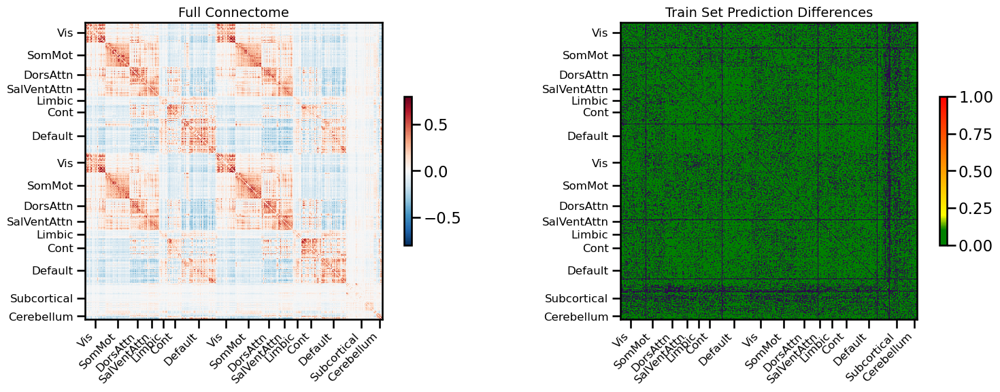

<Figure size 640x480 with 0 Axes>

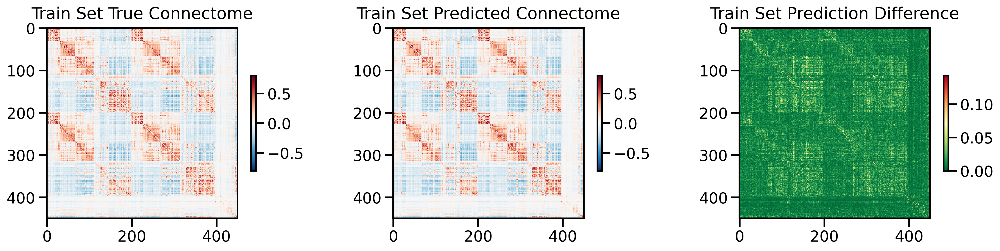

<Figure size 640x480 with 0 Axes>

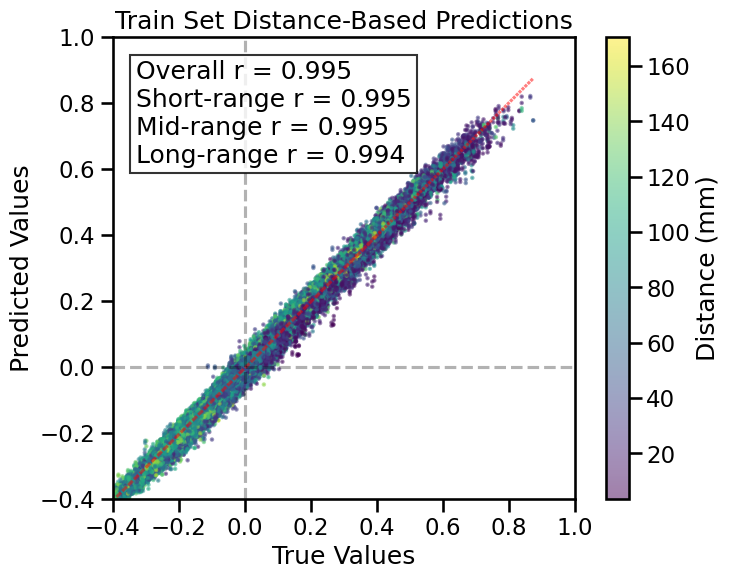

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

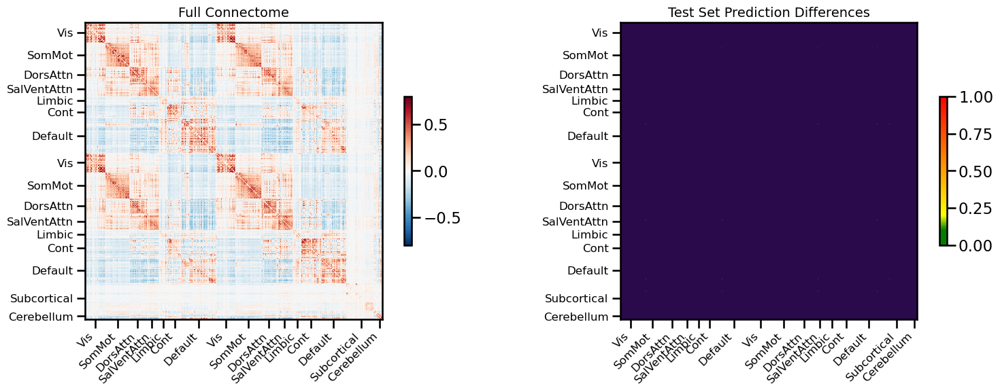

<Figure size 640x480 with 0 Axes>

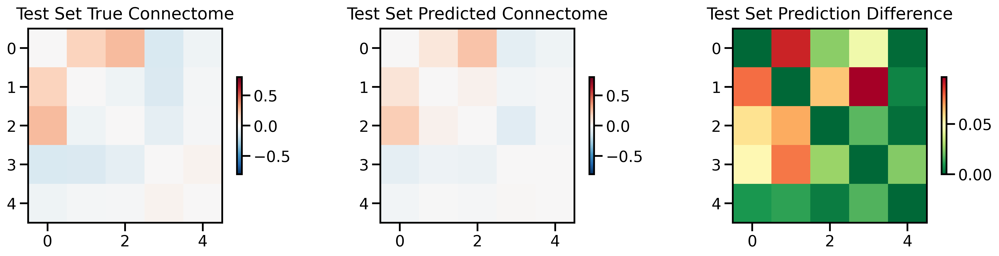

<Figure size 640x480 with 0 Axes>

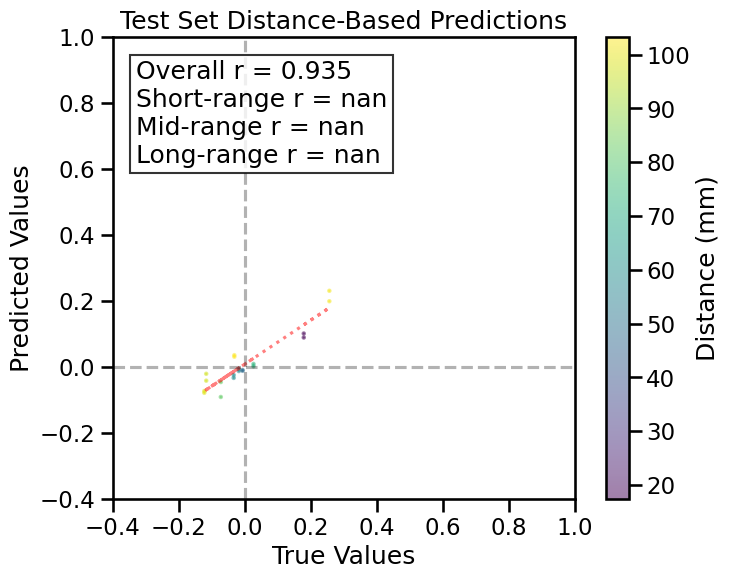

TRAIN METRICS
GLOBAL: mse=0.000253, mae=0.011634, r2=0.9897, pearson_r=0.9952, spearman_r=0.9927, geodesic_distance=12.7879
DISTANCE-BASED: short=0.9954, mid=0.9948, long=0.9944
HEMISPHERIC: left=0.9947, right=0.9958, inter=0.9951
CONNECTION STRENGTH: neg=0.8835, weak=0.9920, pos=0.9707
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9959    0.9954
  Default       0.9950    0.9951
  SalVentAttn    0.9955    0.9949
  Limbic        0.9948    0.9952
  DorsAttn      0.9944    0.9957
  SomMot        0.9959    0.9956
  Vis           0.9959    0.9953
  Subcortical    0.9957    0.9950
  Cerebellum    0.9903    0.9950

TEST METRICS
GLOBAL: mse=0.002405, mae=0.038354, r2=0.8211, pearson_r=0.9352, spearman_r=0.8815, geodesic_distance=2.6167
HEMISPHERIC: left=0.9957, inter=0.9496
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9457
  SalVentAttn       N/A    0.9363
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▃▇▅▄▄▃▂▄▃▁▂▂▂▂▂▂▃▂▂▁▂▁▁▂▁▁▁▁▁▂▁▁▁▁▁▁▂▁▁
train_mse_loss,█▆▅▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.0024
train_mse_loss,0.00085


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 4.7%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 979.49 seconds (16.32 minutes)


8535

<Figure size 640x480 with 0 Axes>

In [15]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_smtcls_full2'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_smtcls_full3'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 7j09jwam
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/7j09jwam
Initialized sweep with ID: 7j09jwam


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'aug_style': 'linear_decay', 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 2173067


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0112
Best val loss so far at epoch 2: 0.0095
Best val loss so far at epoch 3: 0.0095
Best val loss so far at epoch 4: 0.0080
Best val loss so far at epoch 5: 0.0076
Epoch 5/110, Train Loss: 0.0386, Val Loss: 0.0076, Time: 7.49s
Best val loss so far at epoch 6: 0.0073
Best val loss so far at epoch 7: 0.0073
Best val loss so far at epoch 8: 0.0068
Best val loss so far at epoch 9: 0.0050
Best val loss so far at epoch 10: 0.0042
Epoch 10/110, Train Loss: 0.0207, Val Loss: 0.0042, Time: 7.62s
Epoch 15/110, Train Loss: 0.0156, Val Loss: 0.0108, Time: 7.77s
Best val loss so far at epoch 20: 0.0033
Epoch 20/110, Train Loss: 0.0104, Val Loss: 0.0033, Time: 7.62s
Epoch 25/110, Train Loss: 0.0072, Val Loss: 0.0033, Time: 8.19s
Epoch 30/110, Train Loss: 0.0052, Val Loss: 0.0057, Time: 7.81s
Best val loss so far at epoch 33: 0.0026
Epoch 35/110, Train Loss: 0.0039, Val Loss: 0.0036, Time: 

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Calling wandb.login() after wandb.init() has no effect.
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 9webwdfq
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/9webwdfq
Initialized sweep with ID: 9webwdfq


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.1, 'dropout_rate': 0.1, 'learning_rate': 0.0005, 'weight_decay': 1e-05, 'batch_size': 1024, 'aug_prob': 0.0, 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 1069826


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.14 GB
Best val loss so far at epoch 1: 0.0533
Best val loss so far at epoch 2: 0.0361
Epoch 5/110, Train Loss: 0.0119, Val Loss: 0.0799, Time: 7.43s
Best val loss so far at epoch 7: 0.0298
Best val loss so far at epoch 9: 0.0104
Epoch 10/110, Train Loss: 0.0053, Val Loss: 0.0146, Time: 7.60s
Best val loss so far at epoch 13: 0.0087
Best val loss so far at epoch 14: 0.0069
Epoch 15/110, Train Loss: 0.0034, Val Loss: 0.0320, Time: 7.43s
Epoch 20/110, Train Loss: 0.0026, Val Loss: 0.0088, Time: 7.46s
Best val loss so far at epoch 23: 0.0049
Epoch 25/110, Train Loss: 0.0021, Val Loss: 0.0153, Time: 7.46s
Epoch 30/110, Train Loss: 0.0017, Val Loss: 0.0130, Time: 7.50s
Epoch 35/110, Train Loss: 0.0016, Val Loss: 0.0062, Time: 7.48s
Epoch 40/110, Train Loss: 0.0014, Val Loss: 0.0090, Time: 7.49s
Epoch 45/110, Train Loss: 0.0013, Val Loss: 0.0092, Time: 7.63s
Epoch 50/110, Train Loss: 0.0012, Val Loss: 0.0096, Time: 7.50s

L

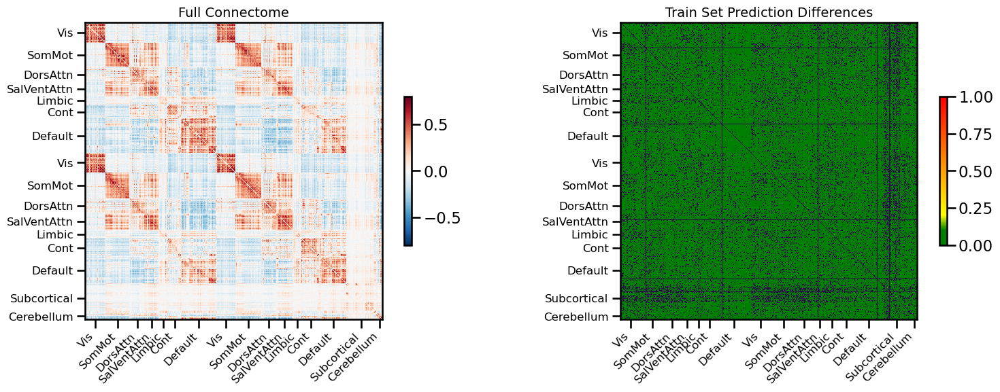

<Figure size 640x480 with 0 Axes>

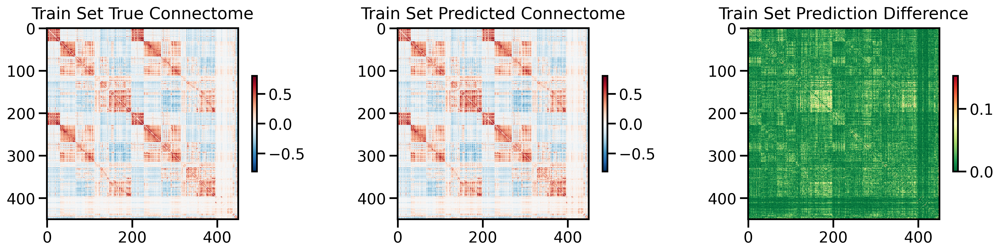

<Figure size 640x480 with 0 Axes>

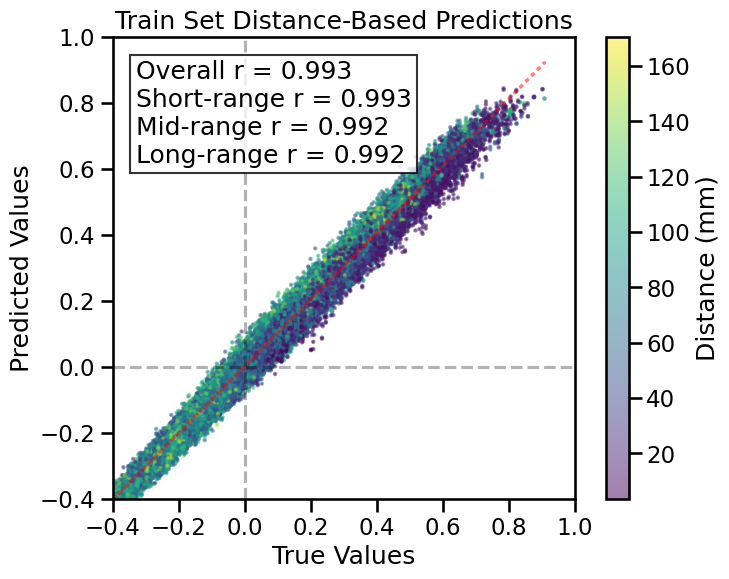

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

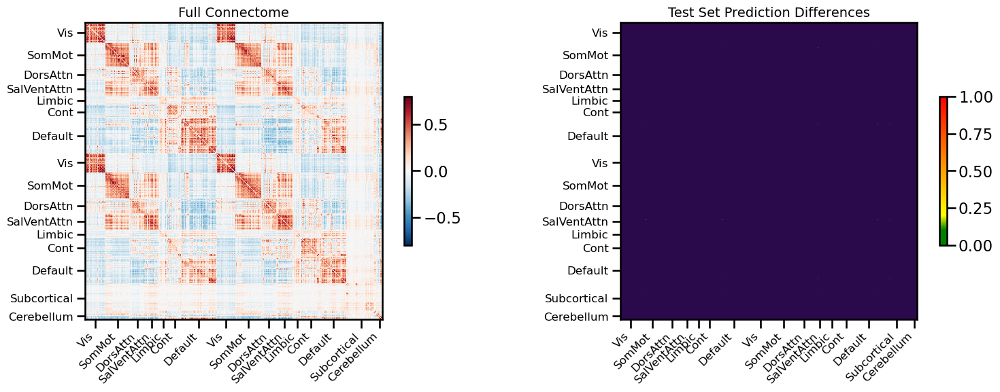

<Figure size 640x480 with 0 Axes>

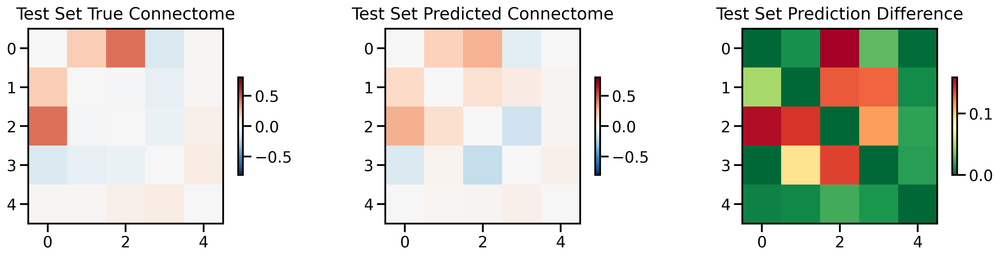

<Figure size 640x480 with 0 Axes>

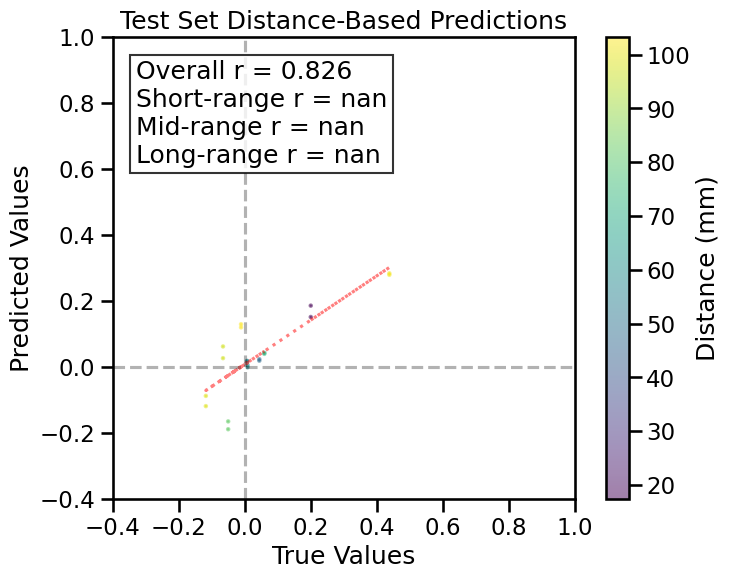

TRAIN METRICS
GLOBAL: mse=0.000528, mae=0.017325, r2=0.9843, pearson_r=0.9926, spearman_r=0.9908, geodesic_distance=14.2300
DISTANCE-BASED: short=0.9931, mid=0.9918, long=0.9921
HEMISPHERIC: left=0.9921, right=0.9933, inter=0.9928
CONNECTION STRENGTH: neg=0.8663, weak=0.9869, pos=0.9504
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9931    0.9938
  Default       0.9912    0.9927
  SalVentAttn    0.9938    0.9933
  Limbic        0.9940    0.9940
  DorsAttn      0.9950    0.9946
  SomMot        0.9933    0.9941
  Vis           0.9947    0.9933
  Subcortical    0.9908    0.9928
  Cerebellum    0.9809    0.9928

TEST METRICS
GLOBAL: mse=0.007438, mae=0.063259, r2=0.6798, pearson_r=0.8265, spearman_r=0.6460, geodesic_distance=3.2759
HEMISPHERIC: left=0.9976, inter=0.8744
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9041
  SalVentAttn       N/A    0.8124
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▆▃▂▂▁▁▂▂▁▂▁▁▁▂▂▁▁▂▁▂▂▁▂▁▂▂▁▁▁▁▁▁▁▂▁▁▁▁
train_mse_loss,█▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00744
train_mse_loss,0.00082


Final evaluation metrics logged successfully.
CPU Usage: 3.6%
RAM Usage: 6.5%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  3% |
Sim complete
Simulation completed in 673.65 seconds (11.23 minutes)


9023

<Figure size 640x480 with 0 Axes>

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_pool',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_smtpool_full'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: v6aygr3g
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/v6aygr3g
Initialized sweep with ID: v6aygr3g


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.1, 'dropout_rate': 0.1, 'cls_dropout': 0.5, 'learning_rate': 0.0005, 'weight_decay': 1e-05, 'batch_size': 1024, 'aug_prob': 0.0, 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS pooled model: 1086978


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.14 GB
Best val loss so far at epoch 1: 0.0144
Epoch 5/110, Train Loss: 0.0249, Val Loss: 0.0175, Time: 7.67s
Epoch 10/110, Train Loss: 0.0133, Val Loss: 0.0206, Time: 7.66s
Epoch 15/110, Train Loss: 0.0066, Val Loss: 0.0510, Time: 7.71s
Epoch 20/110, Train Loss: 0.0034, Val Loss: 0.0205, Time: 7.69s
Best val loss so far at epoch 21: 0.0137
Best val loss so far at epoch 22: 0.0078
Epoch 25/110, Train Loss: 0.0023, Val Loss: 0.0115, Time: 7.74s
Epoch 30/110, Train Loss: 0.0017, Val Loss: 0.0127, Time: 7.76s
Epoch 35/110, Train Loss: 0.0013, Val Loss: 0.0153, Time: 7.70s
Best val loss so far at epoch 38: 0.0067
Best val loss so far at epoch 40: 0.0064
Epoch 40/110, Train Loss: 0.0011, Val Loss: 0.0064, Time: 7.69s
Best val loss so far at epoch 42: 0.0059
Best val loss so far at epoch 45: 0.0053
Epoch 45/110, Train Loss: 0.0010, Val Loss: 0.0053, Time: 7.74s
Best val loss so far at epoch 49: 0.0046
Epoch 50/110, Train Lo

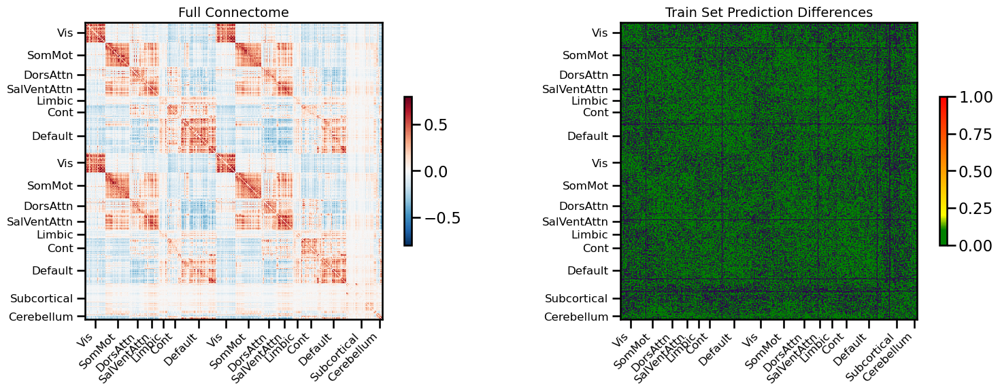

<Figure size 640x480 with 0 Axes>

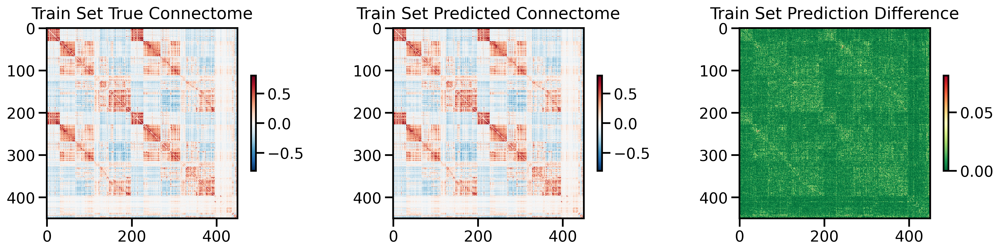

<Figure size 640x480 with 0 Axes>

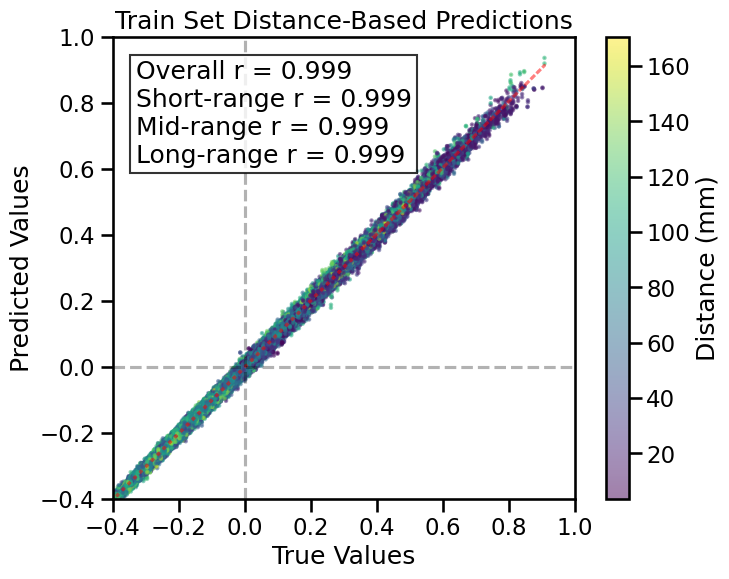

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

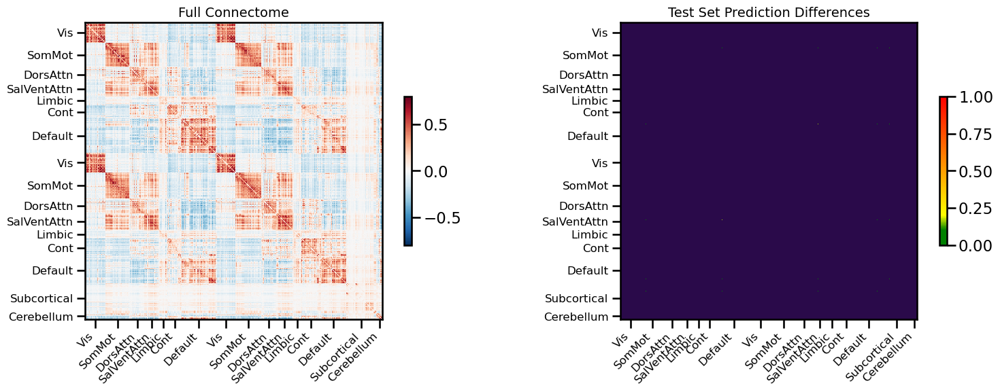

<Figure size 640x480 with 0 Axes>

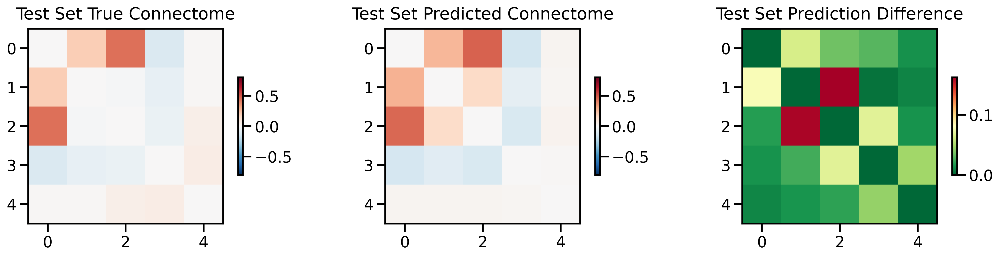

<Figure size 640x480 with 0 Axes>

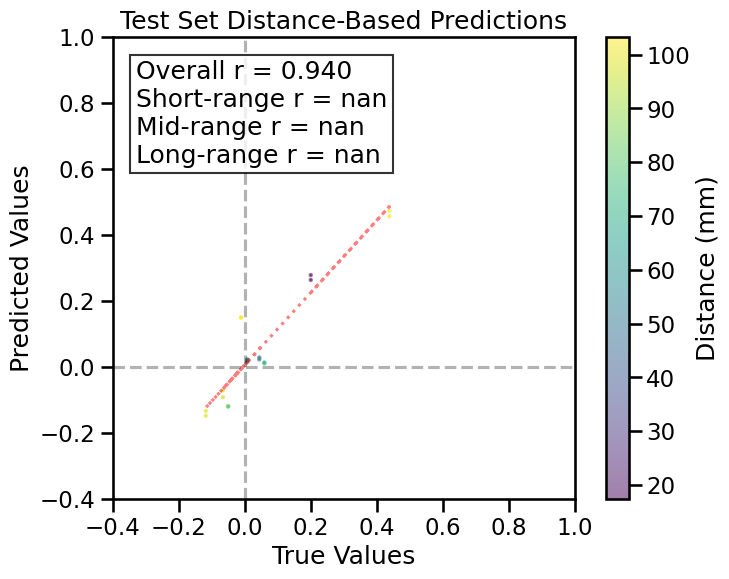

TRAIN METRICS
GLOBAL: mse=0.000089, mae=0.007146, r2=0.9974, pearson_r=0.9987, spearman_r=0.9983, geodesic_distance=10.0953
DISTANCE-BASED: short=0.9988, mid=0.9986, long=0.9986
HEMISPHERIC: left=0.9987, right=0.9987, inter=0.9987
CONNECTION STRENGTH: neg=0.9701, weak=0.9977, pos=0.9917
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9986    0.9988
  Default       0.9984    0.9986
  SalVentAttn    0.9989    0.9987
  Limbic        0.9981    0.9988
  DorsAttn      0.9990    0.9989
  SomMot        0.9990    0.9989
  Vis           0.9991    0.9988
  Subcortical    0.9985    0.9987
  Cerebellum    0.9968    0.9988

TEST METRICS
GLOBAL: mse=0.004042, mae=0.045496, r2=0.8260, pearson_r=0.9396, spearman_r=0.7849, geodesic_distance=3.5247
HEMISPHERIC: left=0.9999, inter=0.9379
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9544
  SalVentAttn       N/A    0.9058
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▃▃▃▅▃▅▇█▅▂▂▃▂▂▂▁▂▂▂▂▁▁▁▂▂▁▁▂▂▁▁▁▁▁▁▂▁▁▁▁
train_mse_loss,██▇▆▅▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00404
train_mse_loss,0.00042


Final evaluation metrics logged successfully.
CPU Usage: 2.6%
RAM Usage: 6.7%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  3% |
Sim complete
Simulation completed in 1038.67 seconds (17.31 minutes)


14516

<Figure size 640x480 with 0 Axes>

In [10]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls_pool',
              use_gpu=True,
              null_model='none',
              use_folds=[0],
              save_model='HCP_smtclspool_full'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()